In [34]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory

import os
#print(os.listdir("/home/hiten/Desktop/Hackathon"))
diri="/home/hiten/Desktop/Hackathon"

In [35]:
import pandas as pd
raw = pd.read_csv(diri+"/label.txt", skipinitialspace=True)
raw

,Label,Name
0,n0,coke
1,n1,doritos
2,n2,kind_protein_bar
3,n3,lays_classic
4,n4,welch_fruit_snack


In [36]:
raw.columns

Index(['Label', 'Name'], dtype='object')

In [37]:
labels = pd.DataFrame()
labels["id"] = raw["Label"].str.strip()
labels["name"] = raw["Name"].str.strip()

In [38]:
labels

,id,name
0,n0,coke
1,n1,doritos
2,n2,kind_protein_bar
3,n3,lays_classic
4,n4,welch_fruit_snack


In [39]:
from IPython.display import Image, display
from keras.preprocessing.image import ImageDataGenerator
from os import listdir
%matplotlib inline

In [47]:
TRAIN_DIR = diri+"/Train"
VALIDATION_DIR = diri+"/Validation"
print(os.listdir(TRAIN_DIR))
print(os.listdir(VALIDATION_DIR))

['n3', 'n0', 'n1', 'n4', 'n2']
['n3', 'n0', 'n1', 'n4', 'n2']


Labels is n0


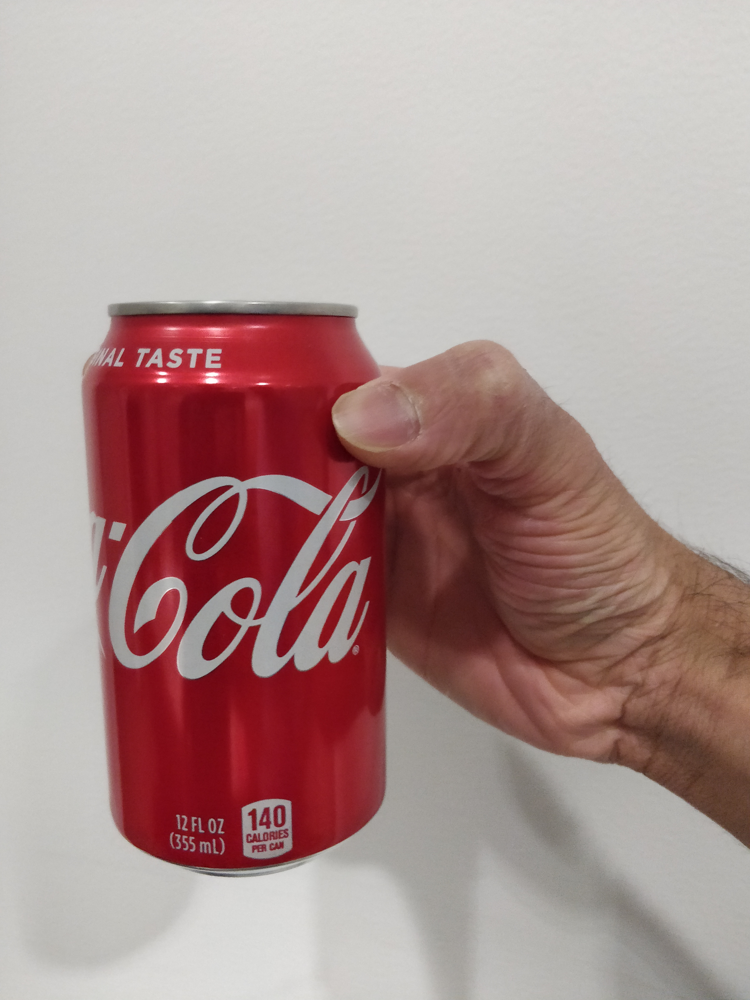

Labels is n1


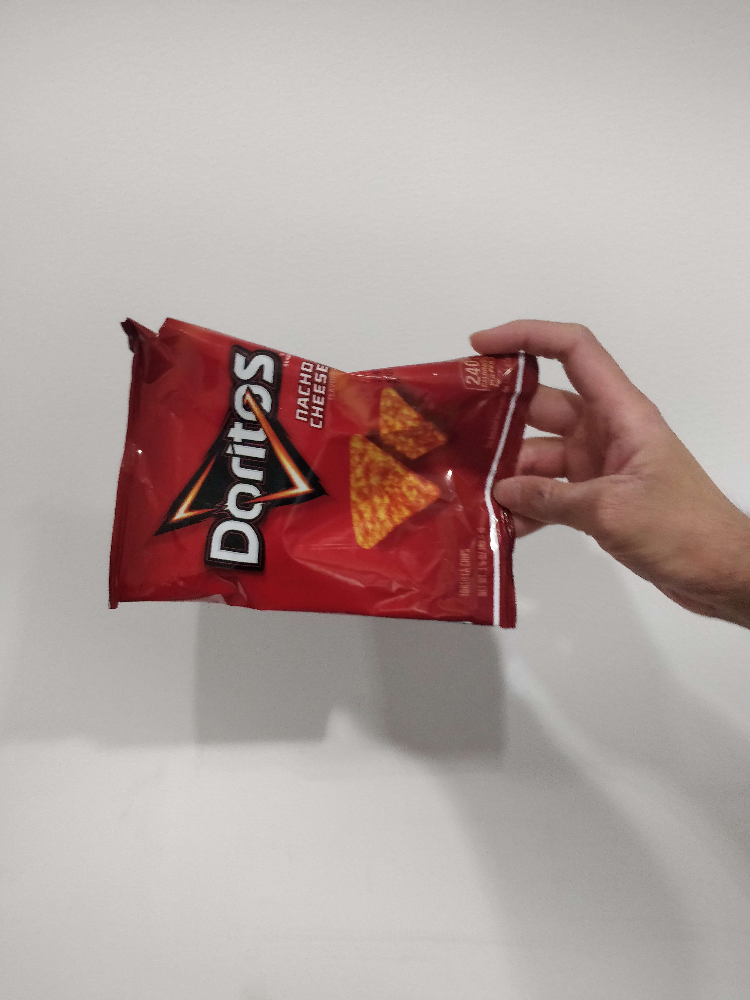

Labels is n2


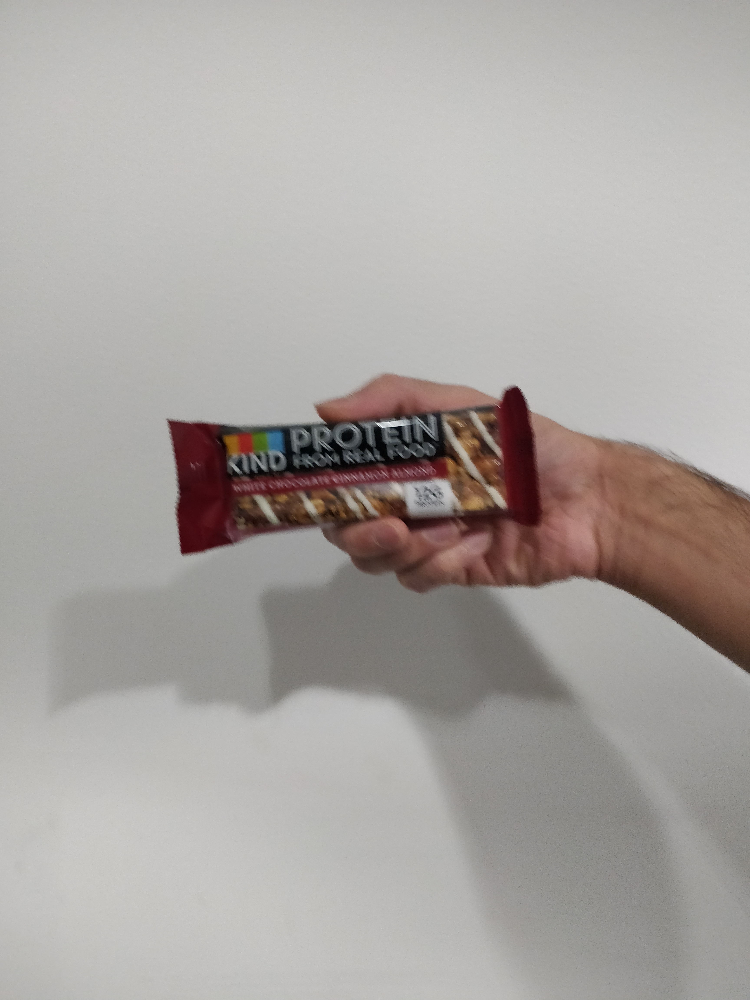

Labels is n3


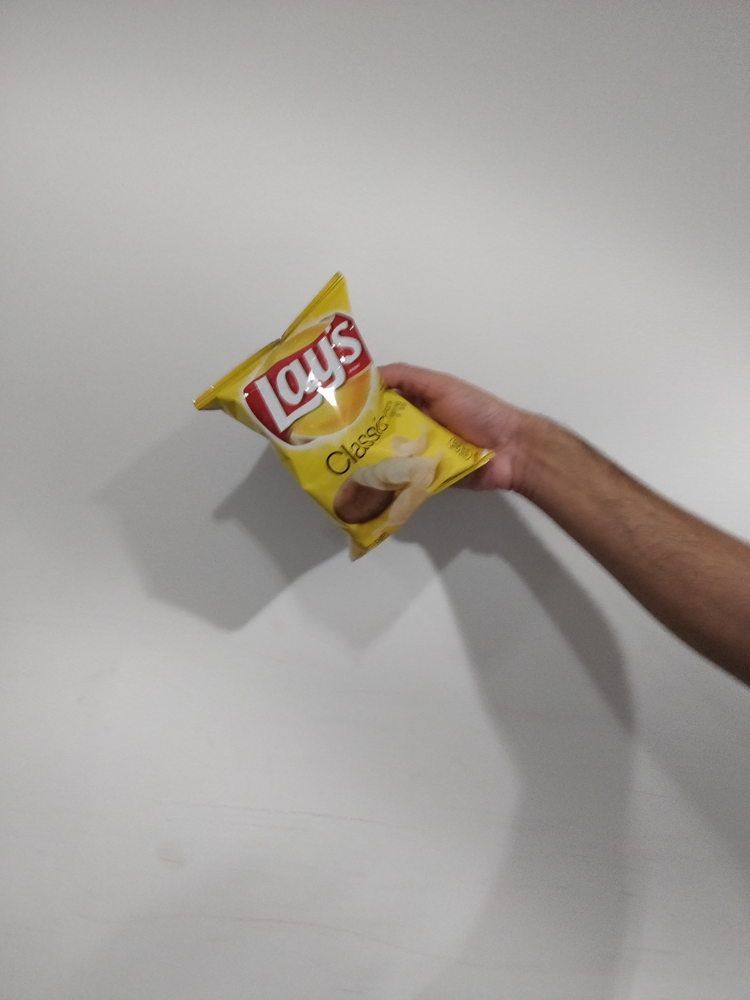

Labels is n4


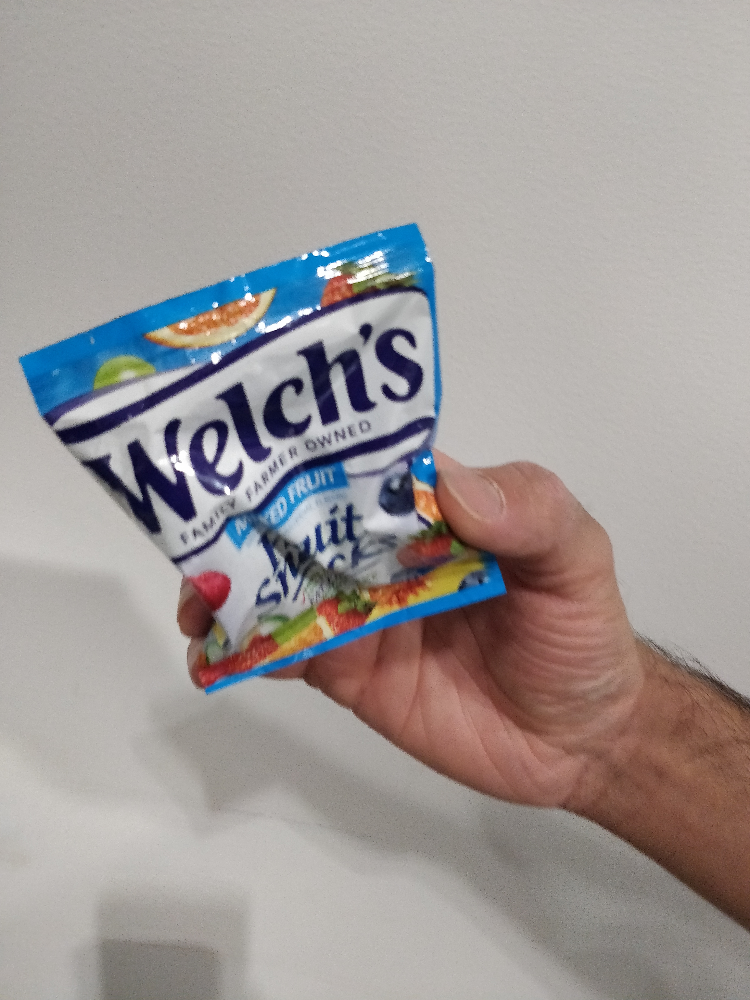

In [48]:
all_ids = labels["id"]

for my_id in labels["id"]:
    images_to_show = 5
    image_dir = TRAIN_DIR +"/"+ "%s/" % my_id
    image_name = listdir(image_dir)[0]
    image_path = image_dir  + image_name
    print("Labels is %s" % my_id)
    display(Image(filename=image_path, width=300, height=300))

In [59]:
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
IMAGE_WIDTH = 300
IMAGE_HEIGHT = 300
BATCH_SIZE = 16

In [50]:
train_datagen = ImageDataGenerator(rescale=1./255,      # We need to normalize the data
                                    rotation_range=40,      # The rest of params will generate us artificial data by manipulating the image
                                    width_shift_range=0.2,
                                    height_shift_range=0.2,
                                    shear_range=0.2,
                                    zoom_range=0.2,
                                    horizontal_flip=True, 
                                    fill_mode='nearest'
                                  )

validation_datagen = ImageDataGenerator(rescale=1./255, # We need to normalize the data
                                  )

train_generator = train_datagen.flow_from_directory(TRAIN_DIR, 
                                                    target_size=(IMAGE_WIDTH, IMAGE_HEIGHT), 
                                                    batch_size = BATCH_SIZE, 
                                                    shuffle=True, # By shuffling the images we add some randomness and prevent overfitting
                                                    class_mode="categorical")

validation_generator = validation_datagen.flow_from_directory(VALIDATION_DIR, 
                                                    target_size=(IMAGE_WIDTH, IMAGE_HEIGHT), 
                                                    batch_size = BATCH_SIZE, 
                                                    shuffle=True,
                                                    class_mode="categorical")

Found 164 images belonging to 5 classes.
Found 164 images belonging to 5 classes.


In [51]:
training_samples = 164
validation_samples = 164
total_steps = training_samples // BATCH_SIZE

In [56]:
from keras.applications import vgg16
model = vgg16.VGG16(weights='imagenet', include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, 3), pooling="max")

for layer in model.layers[:-5]:
        layer.trainable = False
        
for layer in model.layers:
    print(layer, layer.trainable)

ResourceExhaustedError: OOM when allocating tensor of shape [] and type float
	 [[node block1_conv1_2/random_uniform/sub (defined at /home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:4139)  = Const[dtype=DT_FLOAT, value=Tensor<type: float shape: [] values: 0.199501872>, _device="/job:localhost/replica:0/task:0/device:GPU:0"]()]]

Caused by op 'block1_conv1_2/random_uniform/sub', defined at:
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/traitlets/config/application.py", line 658, in launch_instance
    app.start()
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/ipykernel/kernelapp.py", line 505, in start
    self.io_loop.start()
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tornado/platform/asyncio.py", line 132, in start
    self.asyncio_loop.run_forever()
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/asyncio/base_events.py", line 427, in run_forever
    self._run_once()
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/asyncio/base_events.py", line 1440, in _run_once
    handle._run()
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/asyncio/events.py", line 145, in _run
    self._callback(*self._args)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tornado/ioloop.py", line 758, in _run_callback
    ret = callback()
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tornado/stack_context.py", line 300, in null_wrapper
    return fn(*args, **kwargs)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tornado/gen.py", line 1233, in inner
    self.run()
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tornado/gen.py", line 1147, in run
    yielded = self.gen.send(value)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/ipykernel/kernelbase.py", line 357, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tornado/gen.py", line 326, in wrapper
    yielded = next(result)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/ipykernel/kernelbase.py", line 267, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tornado/gen.py", line 326, in wrapper
    yielded = next(result)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/ipykernel/kernelbase.py", line 534, in execute_request
    user_expressions, allow_stdin,
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tornado/gen.py", line 326, in wrapper
    yielded = next(result)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/ipykernel/ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/ipykernel/zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 2819, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 2845, in _run_cell
    return runner(coro)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/IPython/core/async_helpers.py", line 67, in _pseudo_sync_runner
    coro.send(None)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 3020, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 3185, in run_ast_nodes
    if (yield from self.run_code(code, result)):
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 3267, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-56-a4c389d6caa7>", line 2, in <module>
    model = vgg16.VGG16(weights='imagenet', include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, 3), pooling="max")
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/keras/applications/__init__.py", line 28, in wrapper
    return base_fun(*args, **kwargs)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/keras/applications/vgg16.py", line 11, in VGG16
    return vgg16.VGG16(*args, **kwargs)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/keras_applications/vgg16.py", line 112, in VGG16
    name='block1_conv1')(img_input)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/keras/engine/base_layer.py", line 431, in __call__
    self.build(unpack_singleton(input_shapes))
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/keras/layers/convolutional.py", line 141, in build
    constraint=self.kernel_constraint)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/keras/legacy/interfaces.py", line 91, in wrapper
    return func(*args, **kwargs)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/keras/engine/base_layer.py", line 249, in add_weight
    weight = K.variable(initializer(shape),
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/keras/initializers.py", line 218, in __call__
    dtype=dtype, seed=self.seed)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py", line 4139, in random_uniform
    dtype=dtype, seed=seed)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tensorflow/python/ops/random_ops.py", line 244, in random_uniform
    return math_ops.add(rnd * (maxval - minval), minval, name=name)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tensorflow/python/ops/math_ops.py", line 866, in binary_op_wrapper
    return func(x, y, name=name)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tensorflow/python/ops/gen_math_ops.py", line 8318, in sub
    "Sub", x=x, y=y, name=name)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tensorflow/python/framework/op_def_library.py", line 787, in _apply_op_helper
    op_def=op_def)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tensorflow/python/util/deprecation.py", line 488, in new_func
    return func(*args, **kwargs)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tensorflow/python/framework/ops.py", line 3274, in create_op
    op_def=op_def)
  File "/home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/tensorflow/python/framework/ops.py", line 1770, in __init__
    self._traceback = tf_stack.extract_stack()

ResourceExhaustedError (see above for traceback): OOM when allocating tensor of shape [] and type float
	 [[node block1_conv1_2/random_uniform/sub (defined at /home/hiten/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:4139)  = Const[dtype=DT_FLOAT, value=Tensor<type: float shape: [] values: 0.199501872>, _device="/job:localhost/replica:0/task:0/device:GPU:0"]()]]


In [54]:
model.summary()

NameError: name 'model' is not defined

NameError: name 'tf' is not defined